In [1]:
# Project Template Import Cell
%matplotlib inline
import os
import sys
import math

from __future__ import print_function, division
from inspect import getsourcefile

from IPython.display import FileLink

# Standard Notebook Imports
import matplotlib.pyplot as plt
import numpy as np
import pandas as pd
pd.set_option('display.width', 100)

CURR_PATH = os.path.abspath(getsourcefile(lambda:0)).rsplit('/', 1)[0] # Get filepath of this notebook
module_path = os.path.join(os.path.dirname(CURR_PATH), 'utils') # Make module path for one dir up and one down into utils
if module_path not in sys.path: # Append to system path list
    sys.path.append(module_path)

import utils as utils ; reload(utils)

print('System : Python ', os.sys.version , '\n\n')

print('Directory Structure:')
print(CURR_PATH)
!tree -cn --filelimit 12

# Keras Setup
import keras
print('\n\nKeras version:' , keras.__version__ ,
      ', backend:' , keras.backend.backend(),
      ', image_format:' , keras.backend.image_data_format())

random_seed = 7

print('\n\nEnvironment : ')
FileLink('../../ana_py27_p2.yml')

Using Theano backend.


System : Python  2.7.12 |Anaconda custom (64-bit)| (default, Jul  2 2016, 17:42:40) 
[GCC 4.4.7 20120313 (Red Hat 4.4.7-1)] 


Directory Structure:
/media/david/5C14F53A14F517AA/code/ana_py27_p2/projects/CervicalCancer_
.
├── data
│   ├── train
│   │   ├── Type_1 [250 entries exceeds filelimit, not opening dir]
│   │   ├── Type_2 [781 entries exceeds filelimit, not opening dir]
│   │   └── Type_3 [450 entries exceeds filelimit, not opening dir]
│   ├── test
│   │   └── unknown [512 entries exceeds filelimit, not opening dir]
│   ├── preview
│   ├── results
│   ├── sample
│   │   ├── results
│   │   ├── train
│   │   │   ├── Type_1 [35 entries exceeds filelimit, not opening dir]
│   │   │   ├── Type_2 [106 entries exceeds filelimit, not opening dir]
│   │   │   └── Type_3 [62 entries exceeds filelimit, not opening dir]
│   │   ├── valid
│   │   │   ├── Type_1
│   │   │   │   ├── 180.jpg
│   │   │   │   ├── 191.jpg
│   │   │   │   ├── 342.jpg
│   │   │   │   ├── 416.jpg
│   │   │   │   ├

/media/david/5C14F53A14F517AA/code/ana_py27_p2/ana_py27_p2.yml

In [2]:
import cv2
# Just focusing on our sample of training data and assuming it is representative
# Get all training filepaths into a dataframe, along with class, and image dims
train_data_dir = 'data/sample/train'
filenames = [] ; labels = [] ; image_dims = []

for type_num, ctype in enumerate(['Type_1','Type_2','Type_3']):
    type_filenames = utils.get_non_hidden_dir_contents(os.path.join(train_data_dir, ctype))
    filenames.extend(type_filenames) ; labels.extend([type_num+1]* len(type_filenames))
    for img in type_filenames:
        cvimg = cv2.imread(img)
        image_dims.extend([cvimg.shape])
        
image_dims_arr = np.array(image_dims)    
df = pd.DataFrame({'file':filenames,
                   'type':labels,
                   'height':image_dims_arr[:,0:1].reshape((image_dims_arr.shape[0])),
                   'width':image_dims_arr[:,1:2].reshape((image_dims_arr.shape[0])),
                   'channels':image_dims_arr[:,2:3].reshape((image_dims_arr.shape[0])),
                  })

df['hxw'] = df['height'].apply(lambda x: str(x)) + 'x' + df['width'].apply(lambda x: str(x))
print(df.head())

   channels                               file  height  type  width        hxw
0         3   data/sample/train/Type_1/396.jpg    3264     1   2448  3264x2448
1         3     data/sample/train/Type_1/0.jpg    3264     1   2448  3264x2448
2         3   data/sample/train/Type_1/102.jpg    3264     1   2448  3264x2448
3         3  data/sample/train/Type_1/1024.jpg    3264     1   2448  3264x2448
4         3  data/sample/train/Type_1/1071.jpg    3264     1   2448  3264x2448


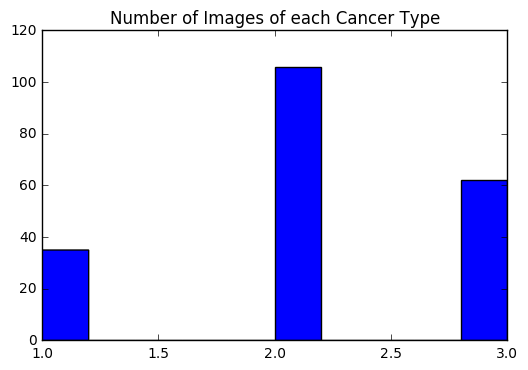

In [3]:
plt.hist(df['type']);
plt.title('Number of Images of each Cancer Type')
plt.show();

3264x2448    96
4128x3096    88
4160x3120     7
4128x2322     5
2448x3264     4
3096x4128     2
640x480       1
Name: hxw, dtype: int64


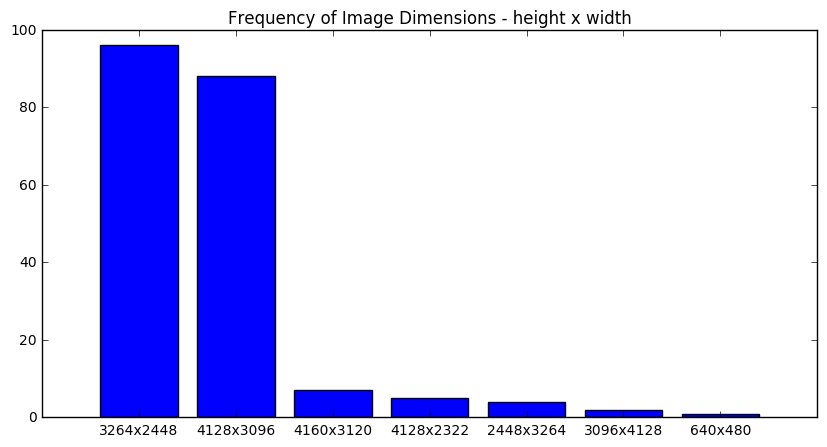

In [4]:
img_dims = df['hxw'].value_counts().index
img_dim_counts = df['hxw'].value_counts().values
img_dim_range= np.arange(len(img_dims))
print(df['hxw'].value_counts())
plt.figure(figsize={10,5})
plt.bar(img_dim_range, img_dim_counts, align='center')
plt.xticks(img_dim_range,img_dims)
plt.title('Frequency of Image Dimensions - height x width')
plt.show();

Type 1 Sample Images


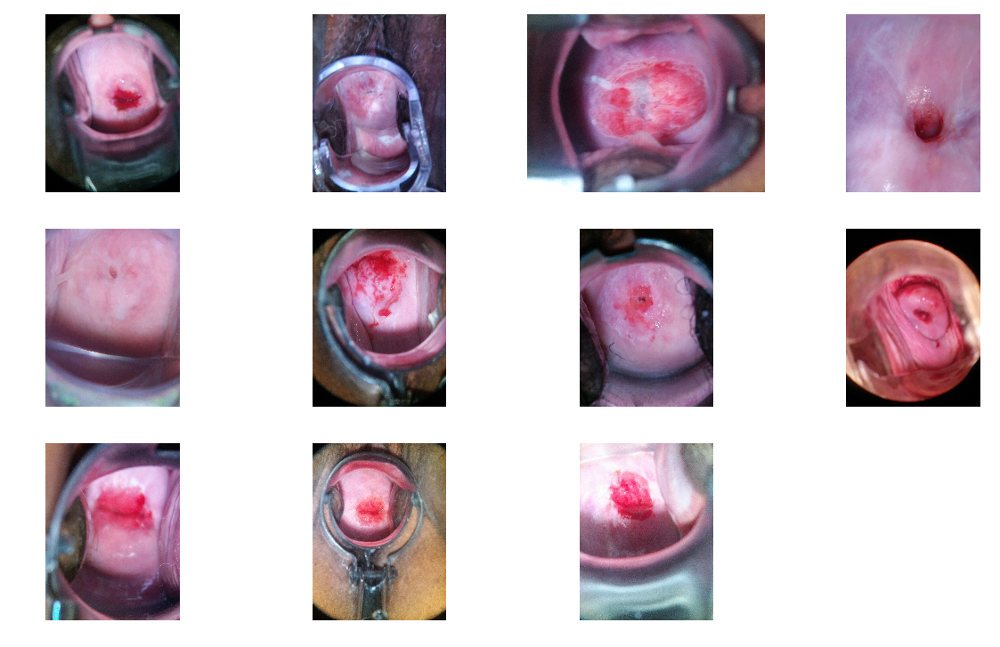

In [5]:
print('Type 1 Sample Images')
type_samples,_ = utils.get_random_sample_images(os.path.join(train_data_dir, 'Type_1'),11)
utils.plot_image_grid(type_samples)

Type 2 Sample Images


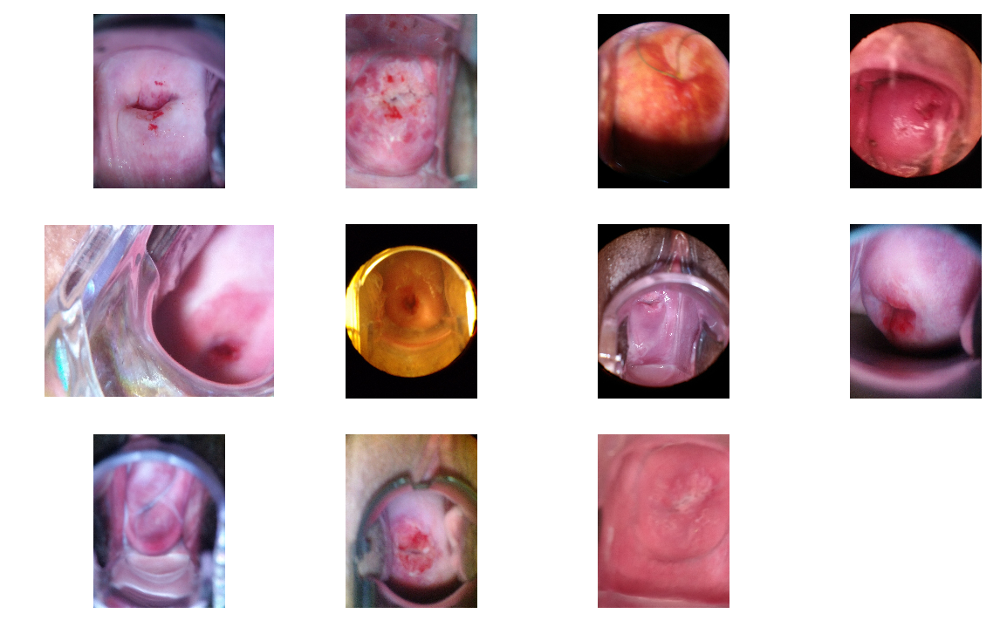

In [6]:
print('Type 2 Sample Images')
type_samples,_ = utils.get_random_sample_images(os.path.join(train_data_dir, 'Type_2'),11)
utils.plot_image_grid(type_samples)

Type 3 Sample Images


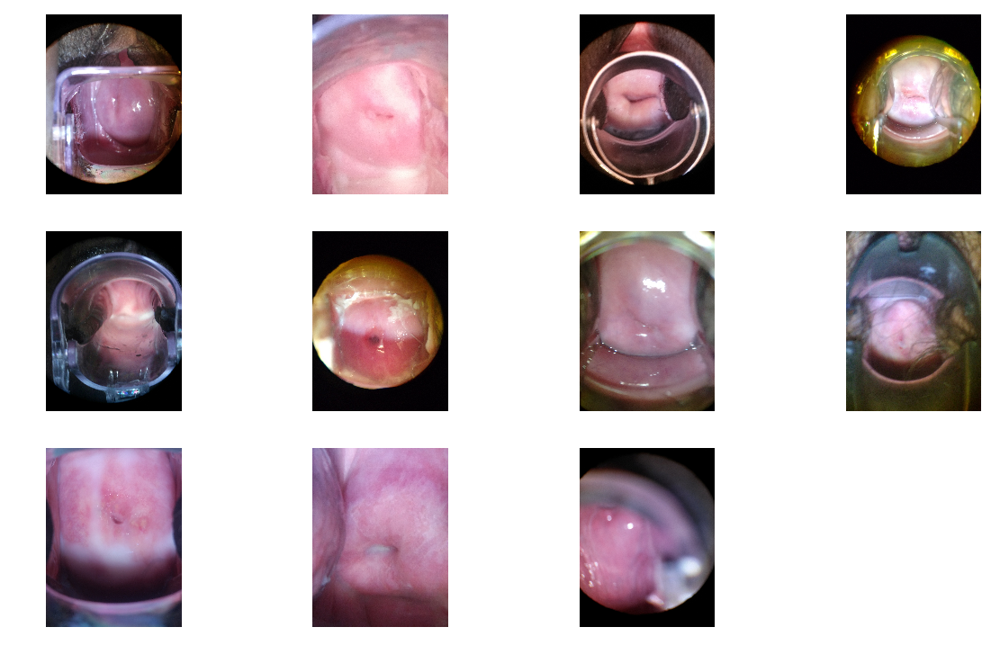

In [7]:
print('Type 3 Sample Images')
type_samples,_ = utils.get_random_sample_images(os.path.join(train_data_dir, 'Type_3'),11)
utils.plot_image_grid(type_samples)

### How to identify the Cervix within the Image

Based on these samples, there is a fair amount of irrelevant data in the images

Maybe feature detection and extraction could help to remove noise

The only relevant part of each image is the cervix itself

What is a simple way of extracting the cervix area?

I think that the cervix is a distinctive color, pink or red, and it seems to be the most illuiminated part of the image - What about finding the biggest area that is above a 'pink bright' threshold, and forming a bounding box based on this?

To investigate this, pick a few images, and review the histograms

In [8]:
type_1_filepaths = utils.get_non_hidden_dir_contents('data/sample/train/Type_1')
f = type_1_filepaths[8] #6
print(f)
img = cv2.imread(f)

data/sample/train/Type_1/1194.jpg


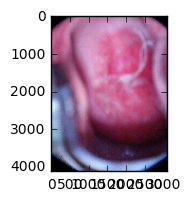

In [9]:
# OpenCV reads files as BGR, convert to RGB
img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
def show(image):
    # Figure size in inches
    plt.figure(figsize=(2, 2))
    # Show image, with nearest neighbour interpolation
    plt.imshow(image, interpolation='nearest');
show(img)

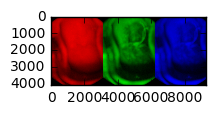

In [10]:
# Show Red/Green/Blue
images = []
for i in [0, 1, 2]:
    colour = img.copy()
    if i != 0: colour[:,:,0] = 0
    if i != 1: colour[:,:,1] = 0
    if i != 2: colour[:,:,2] = 0
    images.append(colour)

show(np.hstack(images))

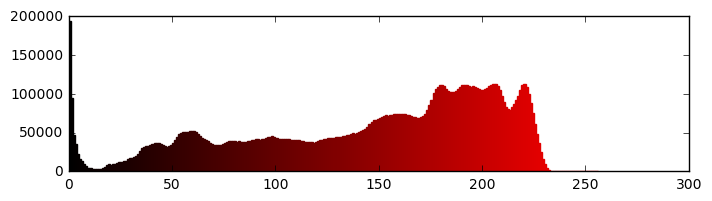

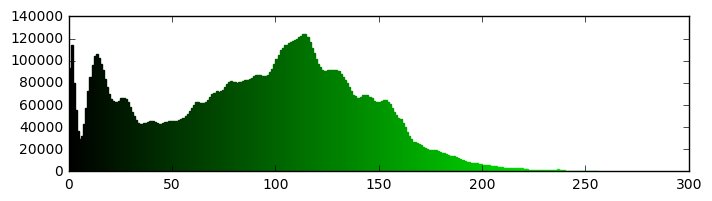

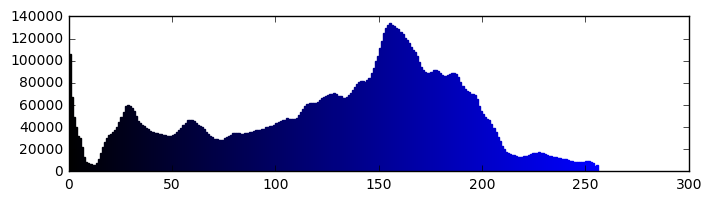

In [11]:
def show_rgb_hist(image):
    colours = ('r','g','b')
    for i, c in enumerate(colours):
        plt.figure(figsize=(8, 2))
        histr = cv2.calcHist([image], [i], None, [256], [0, 256])

        if c == 'r': colours = [((i/256, 0, 0)) for i in range(0, 256)]
        if c == 'g': colours = [((0, i/256, 0)) for i in range(0, 256)]
        if c == 'b': colours = [((0, 0, i/256)) for i in range(0, 256)]

        plt.bar(range(0, 256), histr, color=colours, edgecolor=colours, width=1)

        plt.show()

show_rgb_hist(img)

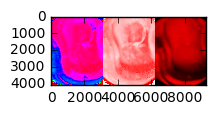

In [12]:
# Convert from RGB to HSV
hsv = cv2.cvtColor(img, cv2.COLOR_RGB2HSV)

images = []
for i in [0, 1, 2]:
    colour = hsv.copy()
    if i != 0: colour[:,:,0] = 0
    if i != 1: colour[:,:,1] = 255
    if i != 2: colour[:,:,2] = 255
    images.append(colour)

hsv_stack = np.hstack(images)
rgb_stack = cv2.cvtColor(hsv_stack, cv2.COLOR_HSV2RGB)
#plt.figure(figsize=(15, 15))
show(rgb_stack)

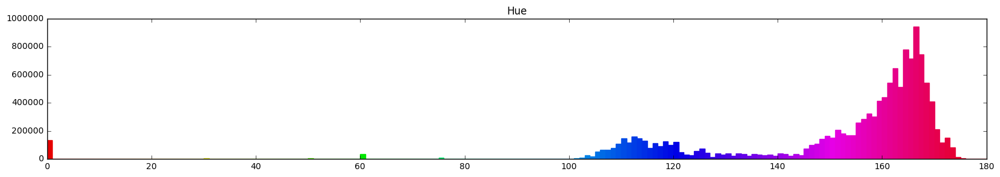

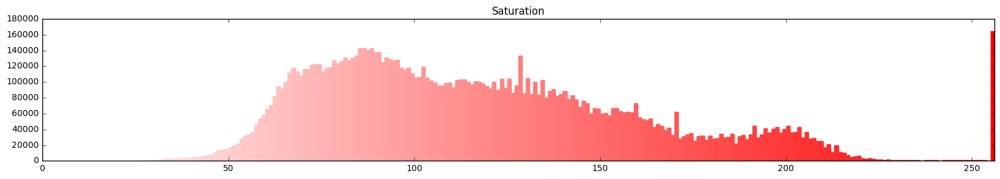

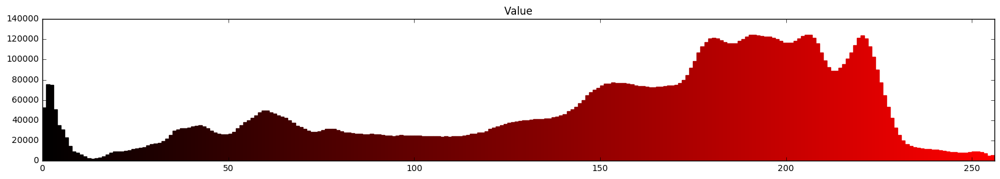

In [13]:
import matplotlib
from matplotlib import colors
#matplotlib.rcParams.update({'font.size': 16})

def show_hsv_hist(image):
    # Hue
    plt.figure(figsize=(20, 3))
    histr = cv2.calcHist([image], [0], None, [180], [0, 180])
    plt.xlim([0, 180])
    colours = [colors.hsv_to_rgb((i/180, 1, 0.9)) for i in range(0, 180)]
    plt.bar(range(0, 180), histr, color=colours, edgecolor=colours, width=1)
    plt.title('Hue')

    # Saturation
    plt.figure(figsize=(20, 3))
    histr = cv2.calcHist([image], [1], None, [256], [0, 256])
    plt.xlim([0, 256])

    colours = [colors.hsv_to_rgb((0, i/256, 1)) for i in range(0, 256)]
    plt.bar(range(0, 256), histr, color=colours, edgecolor=colours, width=1)
    plt.title('Saturation')

    # Value
    plt.figure(figsize=(20, 3))
    histr = cv2.calcHist([image], [2], None, [256], [0, 256])
    plt.xlim([0, 256])

    colours = [colors.hsv_to_rgb((0, 1, i/256)) for i in range(0, 256)]
    plt.bar(range(0, 256), histr, color=colours, edgecolor=colours, width=1)
    plt.title('Value')

show_hsv_hist(hsv)

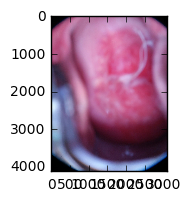

In [14]:
# Blur image slightly
image_blur = cv2.GaussianBlur(img, (7, 7), 0)
show(image_blur)

In [15]:
image_blur_hsv = cv2.cvtColor(image_blur, cv2.COLOR_RGB2HSV)

# 0-10 hue
min_red = np.array([140, 1, 150])
max_red = np.array([180, 250, 256])
image_red1 = cv2.inRange(image_blur_hsv, min_red, max_red)

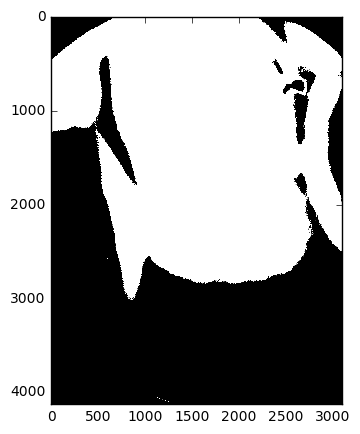

In [16]:
def show_mask(mask):
    plt.figure(figsize=(5, 5))
    plt.imshow(mask, cmap='gray')
show_mask(image_red1)
red_mask = image_red1
image_red = red_mask

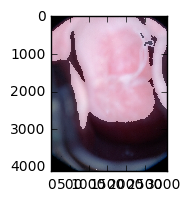

In [17]:
#red_mask = image_red_closed_then_opened
def overlay_mask(mask, image):
    rgb_mask = cv2.cvtColor(mask, cv2.COLOR_GRAY2RGB)
    img = cv2.addWeighted(rgb_mask, 0.5, image, 0.5, 0)
    show(img)
overlay_mask(red_mask, img)

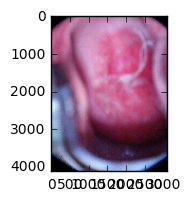

In [18]:
show(img)

### Simple HSV Threshold Image Cropper

data/sample/train/Type_1/1093.jpg
<type 'numpy.ndarray'>
(3264, 2448, 3)
uint8
Original Image


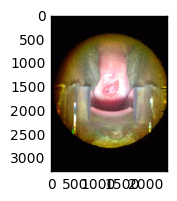

In [19]:
type_1_filepaths = utils.get_non_hidden_dir_contents('data/sample/train/Type_1')
f = type_1_filepaths[6] #8
print(f)
orig = cv2.imread(f)
print(type(orig))
print(orig.shape)
print(orig.dtype)
# Convert to RGB and take a look
rgb = cv2.cvtColor(orig, cv2.COLOR_BGR2RGB)
print('Original Image')
show(rgb)

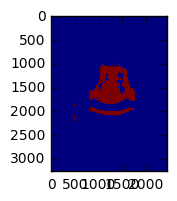

In [20]:
# Convert to HSV
hsv = cv2.cvtColor(orig, cv2.COLOR_BGR2HSV)
# Guesses based on reviewing a few HSV Histograms
pinkMin = (140,1,150) 
pinkMax = (180,250,256)

mask = cv2.inRange(hsv, pinkMin, pinkMax)
#res = cv2.bitwise_and(frame, frame, mask=mask)
#mask2 = cv2.dilate(mask, None, iterations=1)
show(mask)

After Cropping  (1270, 1321, 3)
Original Image  (3264, 2448, 3)


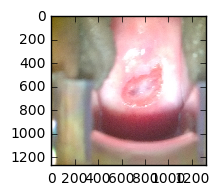

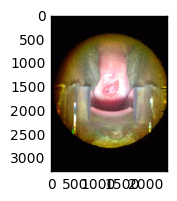

In [21]:
# Crop the image to the bounding box of the mask
i, j = np.where(mask)
indices = np.meshgrid(np.arange(min(i), max(i) + 1),
                      np.arange(min(j), max(j) + 1),
                      indexing='ij')
cropped_image = rgb[indices]
print('After Cropping ' , cropped_image.shape)
show(cropped_image)
print('Original Image ' , rgb.shape)
show(rgb)

### Utils Function - Simple Cervix Finder

In [22]:
def cropper(image_filepath_list, min_params=(140,1,150), max_params=(180,250,256)):
    """
    Accepts a list of file paths for pocessing, a tuple of min parameters e.g (140,1,150), and a tuple of maxparams
    Crops the images, and saves on top of the original images i.e. The original images are replaced!
    """
    try:
        for fp in image_filepath_list:
            img = cv2.imread(fp)
            # Cropping is based on HSV color space & images are BGR, so convert
            hsv = cv2.cvtColor(img, cv2.COLOR_BGR2HSV)
            mask = cv2.inRange(hsv, min_params, max_params)
            # Find bounding box
            i, j = np.where(mask)
            indices = np.meshgrid(np.arange(min(i), max(i) + 1),
                                  np.arange(min(j), max(j) + 1),
                                  indexing='ij')
            cropped_image = img[indices]
            cv2.imwrite(fp, cropped_image)
    except:
        print('Cropper Problem')

Try out this Method
+ Take a sample of images from a directory say sample/Train/Type_1, and copy into data/sample/preview
+ Process the images in the preview directory
+ Do a side by side review

In [23]:
image_filepath_list = utils.get_non_hidden_dir_contents('data/sample/preview')
print(len(image_filepath_list))

35


In [24]:
# Don't keep re-running this function
#cropper(image_filepath_list)

In [25]:
import itertools
orig_file_names = [os.path.join('data/sample/train/Type_1', fn.split('/')[-1]) for
                                fn in image_filepath_list]
#print(orig_file_names)
iters = [iter(orig_file_names), iter(image_filepath_list)]
image_list = list(it.next() for it in itertools.cycle(iters))
#print(image_list)


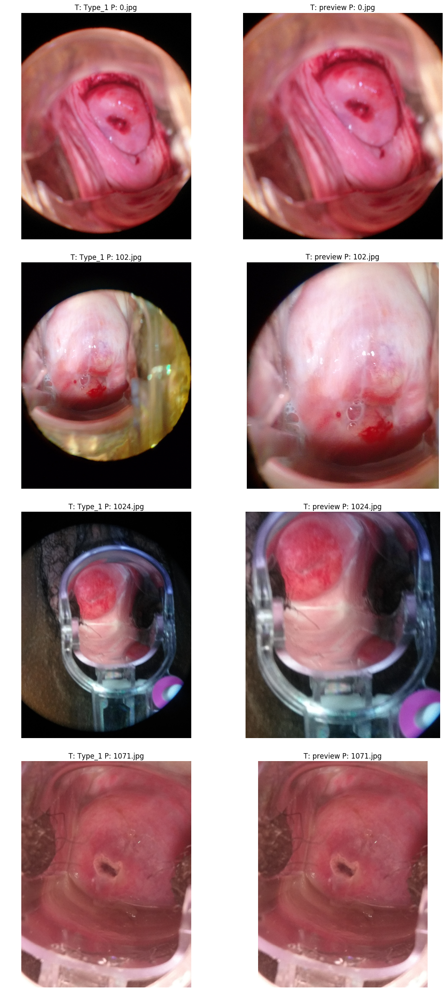

In [27]:
start=0
stop=8
img_list = [cv2.imread(fn) for fn in image_list[start:stop]]
class_list = [fn.split('/')[-2] for fn in image_list[start:stop]]
img_name_list = [fn.split('/')[-1] for fn in image_list[start:stop]]
utils.plot_image_grid(img_list, true_class_list=class_list, pred_class_list=img_name_list, cols=2)

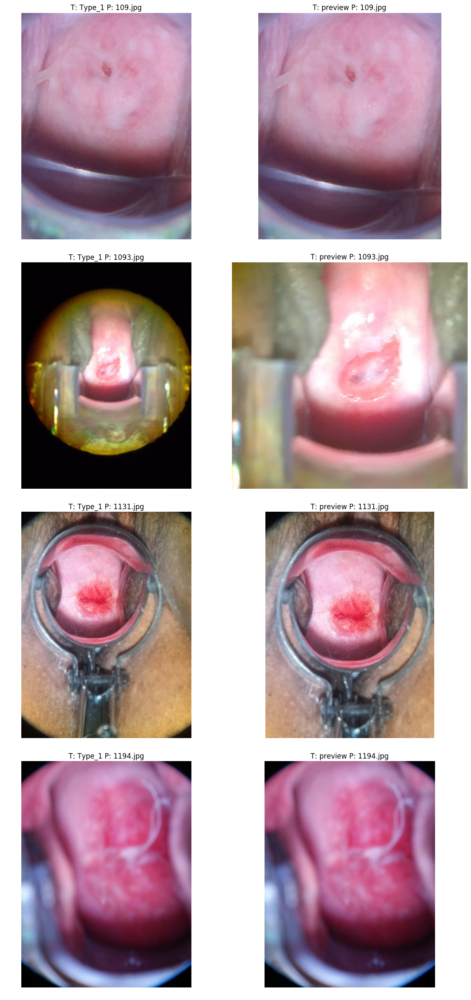

In [28]:
start=8
stop=16
img_list = [cv2.imread(fn) for fn in image_list[start:stop]]
class_list = [fn.split('/')[-2] for fn in image_list[start:stop]]
img_name_list = [fn.split('/')[-1] for fn in image_list[start:stop]]
utils.plot_image_grid(img_list, true_class_list=class_list, pred_class_list=img_name_list, cols=2)

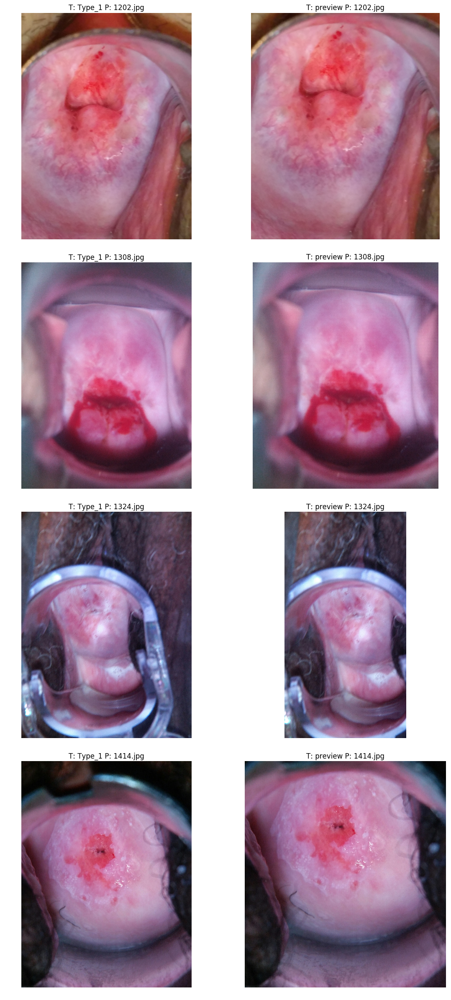

In [29]:
start=16
stop=24
img_list = [cv2.imread(fn) for fn in image_list[start:stop]]
class_list = [fn.split('/')[-2] for fn in image_list[start:stop]]
img_name_list = [fn.split('/')[-1] for fn in image_list[start:stop]]
utils.plot_image_grid(img_list, true_class_list=class_list, pred_class_list=img_name_list, cols=2)

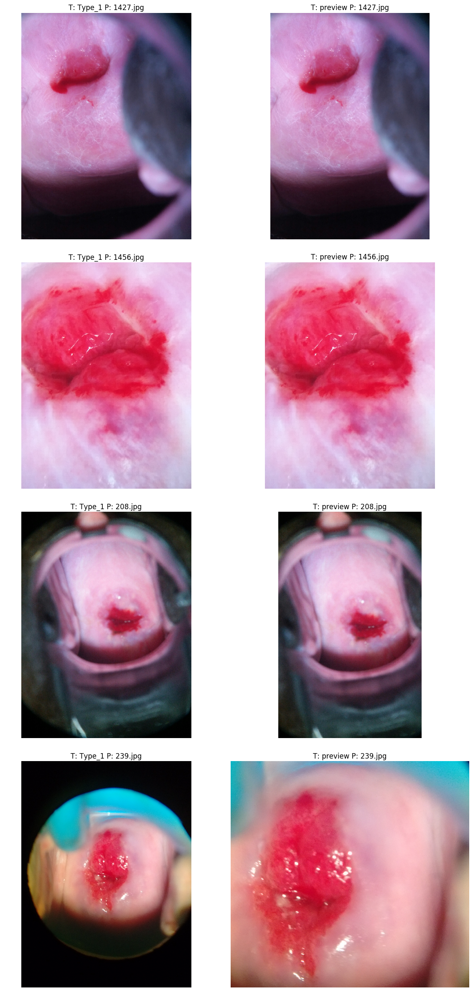

In [30]:
start=24
stop=32
img_list = [cv2.imread(fn) for fn in image_list[start:stop]]
class_list = [fn.split('/')[-2] for fn in image_list[start:stop]]
img_name_list = [fn.split('/')[-1] for fn in image_list[start:stop]]
utils.plot_image_grid(img_list, true_class_list=class_list, pred_class_list=img_name_list, cols=2)

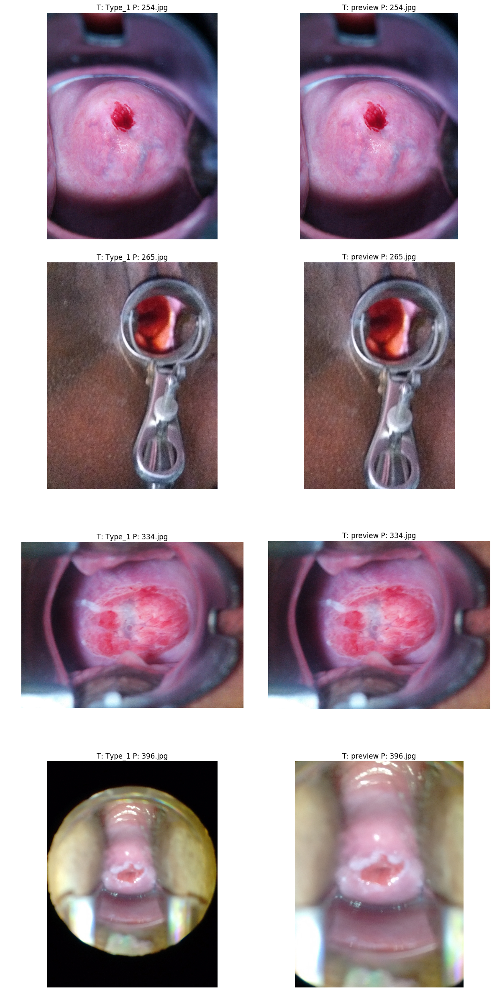

In [31]:
start=32
stop=40
img_list = [cv2.imread(fn) for fn in image_list[start:stop]]
class_list = [fn.split('/')[-2] for fn in image_list[start:stop]]
img_name_list = [fn.split('/')[-1] for fn in image_list[start:stop]]
utils.plot_image_grid(img_list, true_class_list=class_list, pred_class_list=img_name_list, cols=2)

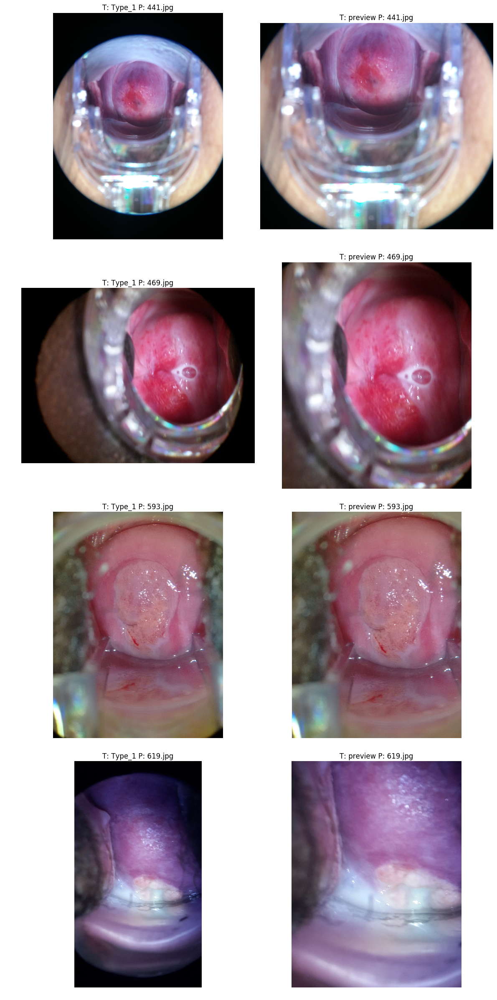

In [32]:
start=40
stop=48
img_list = [cv2.imread(fn) for fn in image_list[start:stop]]
class_list = [fn.split('/')[-2] for fn in image_list[start:stop]]
img_name_list = [fn.split('/')[-1] for fn in image_list[start:stop]]
utils.plot_image_grid(img_list, true_class_list=class_list, pred_class_list=img_name_list, cols=2)

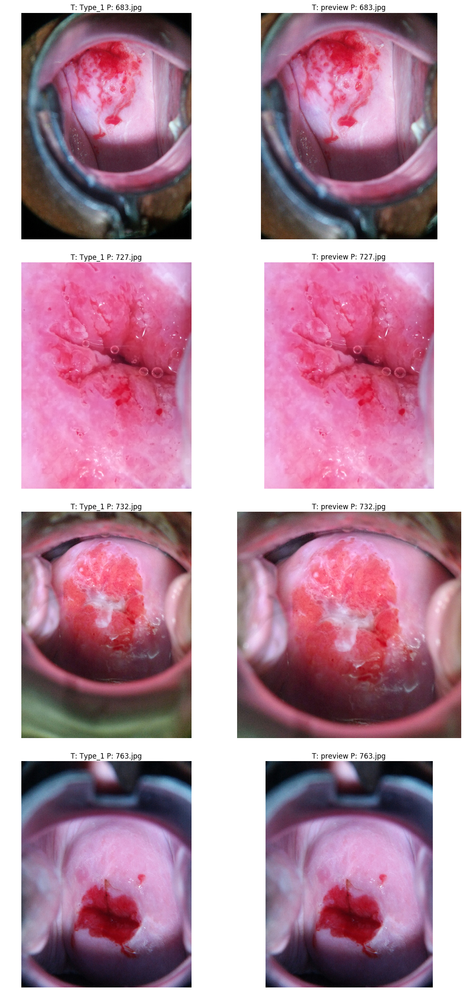

In [33]:
start=48
stop=56
img_list = [cv2.imread(fn) for fn in image_list[start:stop]]
class_list = [fn.split('/')[-2] for fn in image_list[start:stop]]
img_name_list = [fn.split('/')[-1] for fn in image_list[start:stop]]
utils.plot_image_grid(img_list, true_class_list=class_list, pred_class_list=img_name_list, cols=2)

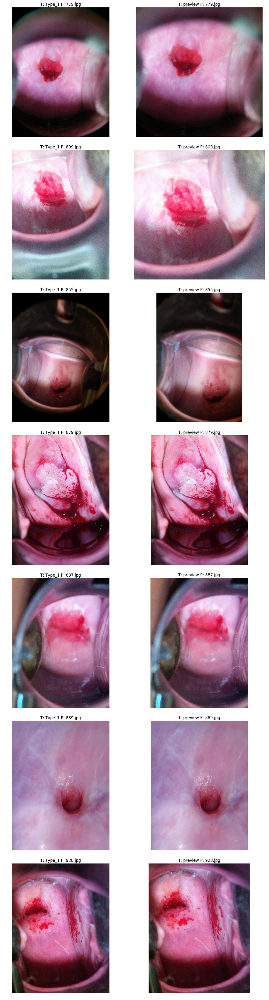

In [34]:
start=56
stop=None
img_list = [cv2.imread(fn) for fn in image_list[start:stop]]
class_list = [fn.split('/')[-2] for fn in image_list[start:stop]]
img_name_list = [fn.split('/')[-1] for fn in image_list[start:stop]]
utils.plot_image_grid(img_list, true_class_list=class_list, pred_class_list=img_name_list, cols=2)

### Review

These are better - I cannot see that any relavant pixels have been removed. If anything, this filter is less aggressive than I was looking for.

Next steps look at the HSV histograms of the disappointing results, and see if the filter can be made a bit more aggressive

Noisiest images are (Most noisy are starred):
+ 855
+ 683
+ 469
+ 441
+ 265*
+ 264
+ 208
+ 1024*
+ 1131*
+ 1427
+ 1324


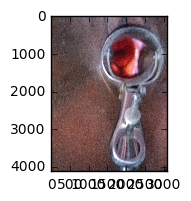

In [158]:
img_fn = 'data/sample/train/Type_1/265.jpg'
img = cv2.imread(img_fn)
img_rgb = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
img_hsv = cv2.cvtColor(img, cv2.COLOR_BGR2HSV)
show(img_rgb)

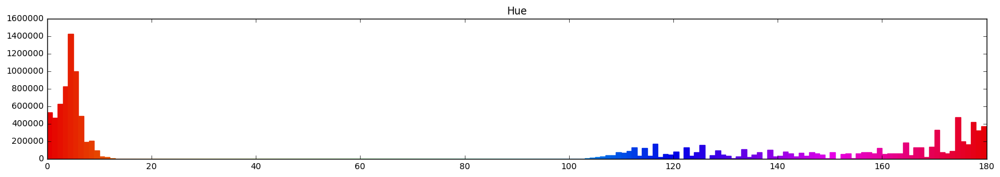

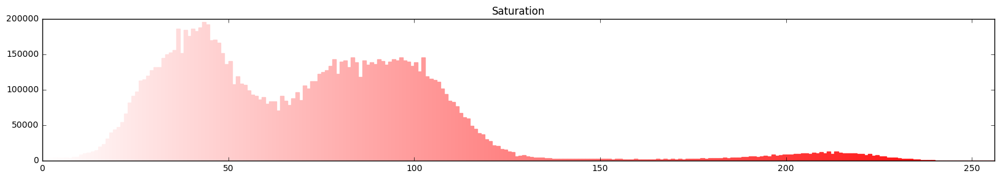

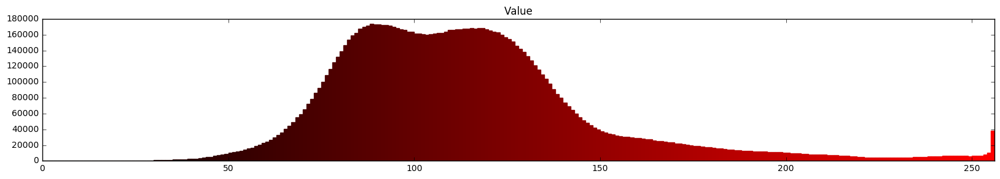

In [159]:
show_hsv_hist(img_hsv)

In [160]:
# Modified to just return the image for viewing
# http://infohost.nmt.edu/tcc/help/pubs/colortheory/web/hsv.html
def cropper_(image_filepath_list, min_params=(130,85,150), max_params=(180,250,256)):
    """
    Accepts a list of file paths for pocessing, a tuple of min parameters e.g (140,1,150), and a tuple of maxparams
    Crops the images, and saves on top of the original images i.e. The original images are replaced!
    """
    try:
        for fp in image_filepath_list:
            img = cv2.imread(fp)
            # Cropping is based on HSV color space & images are BGR, so convert
            hsv = cv2.cvtColor(img, cv2.COLOR_BGR2HSV)
            mask = cv2.inRange(hsv, min_params, max_params)
            # Find bounding box
            i, j = np.where(mask)
            indices = np.meshgrid(np.arange(min(i), max(i) + 1),
                                  np.arange(min(j), max(j) + 1),
                                  indexing='ij')
            cropped_image = img[indices]
            return cropped_image
            #cv2.imwrite(fp, cropped_image)
    except:
        print('Cropper Problem')

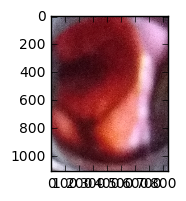

In [161]:
min_params=(150,85,150) ; max_params = (180,256,256)
min_params=(130,85,150) ; max_params = (180,256,256)
cropped_img = cropper_([img_fn], min_params=min_params, max_params=max_params)
cropped_img_rgb = cv2.cvtColor(cropped_img, cv2.COLOR_BGR2RGB)
show(cropped_img_rgb)

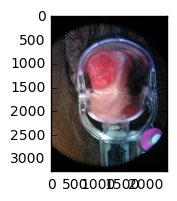

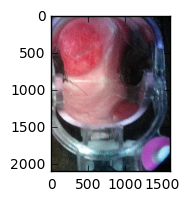

In [162]:
img_fn = 'data/sample/train/Type_1/1024.jpg'
img = cv2.imread(img_fn)
img_rgb = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
img_hsv = cv2.cvtColor(img, cv2.COLOR_BGR2HSV)
show(img_rgb)
#min_params=(140,85,150) ; max_params = (180,256,256)
cropped_img = cropper_([img_fn], min_params=min_params, max_params=max_params)
cropped_img_rgb = cv2.cvtColor(cropped_img, cv2.COLOR_BGR2RGB)
show(cropped_img_rgb)

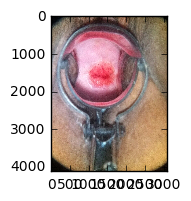

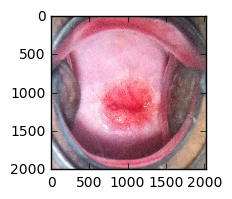

In [163]:
img_fn = 'data/sample/train/Type_1/1131.jpg'
img = cv2.imread(img_fn)
img_rgb = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
img_hsv = cv2.cvtColor(img, cv2.COLOR_BGR2HSV)
show(img_rgb)
#min_params=(140,85,150) ; max_params = (180,256,256)
cropped_img = cropper_([img_fn], min_params=min_params, max_params=max_params)
cropped_img_rgb = cv2.cvtColor(cropped_img, cv2.COLOR_BGR2RGB)
show(cropped_img_rgb)

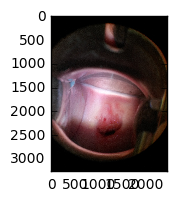

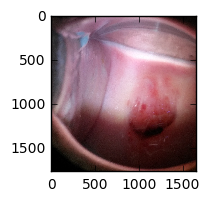

In [164]:
img_fn = 'data/sample/train/Type_1/855.jpg'
img = cv2.imread(img_fn)
img_rgb = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
img_hsv = cv2.cvtColor(img, cv2.COLOR_BGR2HSV)
show(img_rgb)
#min_params=(140,85,150) ; max_params = (180,256,256)
cropped_img = cropper_([img_fn], min_params=min_params, max_params=max_params)
cropped_img_rgb = cv2.cvtColor(cropped_img, cv2.COLOR_BGR2RGB)
show(cropped_img_rgb)

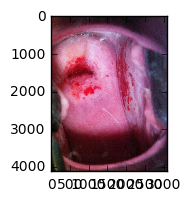

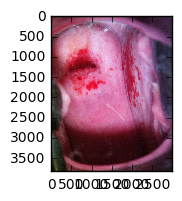

In [165]:
img_fn = 'data/sample/train/Type_1/928.jpg'
img = cv2.imread(img_fn)
img_rgb = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
img_hsv = cv2.cvtColor(img, cv2.COLOR_BGR2HSV)
show(img_rgb)
#min_params=(140,85,150) ; max_params = (180,256,256)
cropped_img = cropper_([img_fn], min_params=min_params, max_params=max_params)
cropped_img_rgb = cv2.cvtColor(cropped_img, cv2.COLOR_BGR2RGB)
show(cropped_img_rgb)

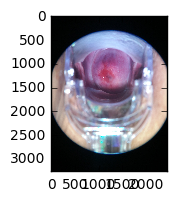

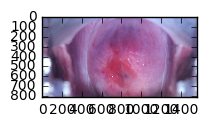

In [166]:
img_fn = 'data/sample/train/Type_1/441.jpg'
img = cv2.imread(img_fn)
img_rgb = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
img_hsv = cv2.cvtColor(img, cv2.COLOR_BGR2HSV)
show(img_rgb)
#min_params=(140,85,150) ; max_params = (180,256,256)
cropped_img = cropper_([img_fn], min_params=min_params, max_params=max_params)
cropped_img_rgb = cv2.cvtColor(cropped_img, cv2.COLOR_BGR2RGB)
show(cropped_img_rgb)

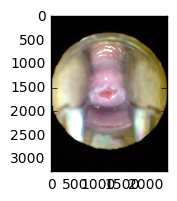

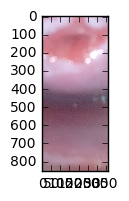

In [167]:
img_fn = 'data/sample/train/Type_1/396.jpg'
img = cv2.imread(img_fn)
img_rgb = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
img_hsv = cv2.cvtColor(img, cv2.COLOR_BGR2HSV)
show(img_rgb)
#min_params=(140,85,150) ; max_params = (180,256,256)
cropped_img = cropper_([img_fn], min_params=min_params, max_params=max_params)
cropped_img_rgb = cv2.cvtColor(cropped_img, cv2.COLOR_BGR2RGB)
show(cropped_img_rgb)